In [29]:
from pymongo import MongoClient
import pprint

import copy
import pandas as pd
import numpy as np

# Requests sends and recieves HTTP requests.
import requests

# Beautiful Soup parses HTML documents in python.
from bs4 import BeautifulSoup

In [5]:
import json

# TODO: this doesn't scale well and doesn't help with looking at the data.
#       Possible solutions: load into pandas dataframe or mongodb, maybe both.
reports = []
with open('data/bigfoot_data.json') as f:
    for i in f:
        reports.append(json.loads(i))

In [11]:
reports

[{'_id': {'$oid': '5939abbd2acdf6607095366c'},
  'url': 'show_report.asp?id=13038',
  'html': '\r\n<!doctype html public "-//w3c//dtd html 4.0 transitional//en">\r\n<HTML>\r\n\t<HEAD>\r\n        <meta http-equiv="X-UA-Compatible" content="IE=EmulateIE7" />\r\n        <meta http-equiv="Content-Type" content="text/html; charset=iso-8859-1">\r\n    <meta name="KEYWORDS" content="bigfoot, big foot, BigFoot, BFRO, Bigfoot research, sightings database, organizations, Organization, sightings, lists, locations, areas, reports, report, ape, apes, forest, giant, giants, monster, monsters, swamp, creek, Florida, Skunk Ape Florida Skuk Ape, Abominable Snowman, Agogwe, Almasti, Batutut-Borneo, Didi, Dwendi, Kakundakari, Kung-Lu, Mapinguary, Muhalu, sasquatch, sasquach, Sedapa, Orang Pendek, Shiru, Sisimite, Skunk Ape, Tok- Burma, Yeti, Yowie, cryptozoology, animals, strange, glowing eyes, foot prints, cast, tracks, fottprint cast, hairy, beast, mystery, paranormal, ufo, x-files, xfiles, bionic woma

In [7]:
reports[0]['html']

'\r\n<!doctype html public "-//w3c//dtd html 4.0 transitional//en">\r\n<HTML>\r\n\t<HEAD>\r\n        <meta http-equiv="X-UA-Compatible" content="IE=EmulateIE7" />\r\n        <meta http-equiv="Content-Type" content="text/html; charset=iso-8859-1">\r\n    <meta name="KEYWORDS" content="bigfoot, big foot, BigFoot, BFRO, Bigfoot research, sightings database, organizations, Organization, sightings, lists, locations, areas, reports, report, ape, apes, forest, giant, giants, monster, monsters, swamp, creek, Florida, Skunk Ape Florida Skuk Ape, Abominable Snowman, Agogwe, Almasti, Batutut-Borneo, Didi, Dwendi, Kakundakari, Kung-Lu, Mapinguary, Muhalu, sasquatch, sasquach, Sedapa, Orang Pendek, Shiru, Sisimite, Skunk Ape, Tok- Burma, Yeti, Yowie, cryptozoology, animals, strange, glowing eyes, foot prints, cast, tracks, fottprint cast, hairy, beast, mystery, paranormal, ufo, x-files, xfiles, bionic woman, sightings, sighting, IVBC, Byrne, report, howl, scream, primate, everglades, Florida Evergl

In [7]:
# finds each key in json file for that record
print(reports[0].keys(), '\n')

# prints each key and value (using f strings)
for k, v in reports[0].items():
    print(f'{k}: {v} \n')

dict_keys(['_id', 'url', 'html', 'time']) 

_id: {'$oid': '5939abbd2acdf6607095366c'} 

url: show_report.asp?id=13038 

html: 
<!doctype html public "-//w3c//dtd html 4.0 transitional//en">
<HTML>
	<HEAD>
        <meta http-equiv="X-UA-Compatible" content="IE=EmulateIE7" />
        <meta http-equiv="Content-Type" content="text/html; charset=iso-8859-1">
    <meta name="KEYWORDS" content="bigfoot, big foot, BigFoot, BFRO, Bigfoot research, sightings database, organizations, Organization, sightings, lists, locations, areas, reports, report, ape, apes, forest, giant, giants, monster, monsters, swamp, creek, Florida, Skunk Ape Florida Skuk Ape, Abominable Snowman, Agogwe, Almasti, Batutut-Borneo, Didi, Dwendi, Kakundakari, Kung-Lu, Mapinguary, Muhalu, sasquatch, sasquach, Sedapa, Orang Pendek, Shiru, Sisimite, Skunk Ape, Tok- Burma, Yeti, Yowie, cryptozoology, animals, strange, glowing eyes, foot prints, cast, tracks, fottprint cast, hairy, beast, mystery, paranormal, ufo, x-files, xfiles,

In [2]:
# with open('data/bigfoot_data.json') as fp:
#     soup = BeautifulSoup(fp, 'html')

In [36]:
# use BeautifulSoup to parse the html
soup = BeautifulSoup(reports[0]['html'], 'html.parser')
type(soup)

bs4.BeautifulSoup

In [148]:
def convert_report(report:dict) -> BeautifulSoup:
    return BeautifulSoup(report['html'], 'html.parser')

def parse_report(cvt_report:BeautifulSoup) -> dict:
    feat_val = build_details([x.get_text() for x in cvt_report.find_all('p')])
    #feat_val_dict = {x[0].lower().strip():x[1] for x in feat_val}
    return feat_val


In [147]:
from bs4 import BeautifulSoup
import pandas as pd
def build_header(str_lst):
    """
    Parameters
    ----------
    str_list: list(str)
        A list of strings
    Returns
    -------
    result : dict
        A dictionary with key, value pairs from processing the header
    """
    result = {}
    # array for geographical information 
    # Example : (Geographical Index > United States > Alaska > Anchorage County > Report # 13038)
    # geographic = [Geographical Index, United States, Alaska, Anchorage County, Report # 13038]
    geographic = [x.strip() for x in str_lst[0].split('>')]
    geo_dict = {}
    geo_dict['region'] = geographic[1]
    geo_dict['state'] = geographic[2]
    geo_dict['detail'] = geographic[3]
    report = geographic[4]
    geo_dict['report'] = report.split(' ')[-1]
    geo_dict['report_class'] = str_lst[2]
    return geo_dict
def build_details(str_lst):
    """
    Parameters
    ----------
    str_list: list(str)
        A list of strings
    Returns
    -------
    result : dict
        A dictionary with key, value pairs from processing the details section
    """
    # empty list to store return key value pairs
    result = {}
    # flag to alter the way we build keys
    process_diff = False
    # empty array to store extra information if process_diff flag is True
    extra = []
    for i, x in enumerate(str_lst):
        # splits each line into a key, value string pair
        first, *second = x.split(':')
        if not first.isupper():    
            # checks if key isn't CAPS, if not we process the rest of the html differently
            process_diff = True
        if not process_diff:
            # we join the second part in case there exists a colon ":" inside the raw text
            result[first.lower().strip()] = (' '.join(second)).strip()
        else:
            # append each extra line to a general array
            extra.append(x)
    # combine all extra values into a single long string
    result['extra'] = ' '.join(extra)
    return result

In [153]:
data = pd.DataFrame(columns=['year', 'season', 'month', 'state', 'county', 'location details', 'nearest town', 'nearest road', 'observed', 'also noticed', 'other witnesses', 'other stories', 'time and conditions', 'environment', 'extra'])
for report in reports:
    cvt_report = convert_report(report)
    parsed = parse_report(cvt_report)
    to_append = pd.Series(parsed)
    data = data.append(to_append, ignore_index=True)
    


In [156]:
data.describe()

,year,season,month,state,county,location details,nearest town,nearest road,observed,also noticed,other witnesses,other stories,time and conditions,environment,extra,date,see photos from silver star mountain,country,province
count,4799,4799,4181,4540,4540,4047,4440,4086,4767,3182,4321,3380,4288,4513,4857,3222,1,259,259
unique,428,5,12,49,1003,3984,3630,3559,4763,2811,3548,2763,4216,4439,4122,1121,1,1,9
top,2004,Summer,August,Washington,Pierce County,(edited),Strawberry,101,,no,No,No,Afternoon,Pine forest,,15,,Canada,British Columbia
freq,192,1792,575,528,71,16,9,16,4,76,103,176,9,13,705,184,1,259,118


In [159]:
data.to_csv('data/big_foot.csv')

In [10]:
print(soup.prettify())

<!DOCTYPE doctype html public "-//w3c//dtd html 4.0 transitional//en">
<html>
 <head>
  <meta content="IE=EmulateIE7" http-equiv="X-UA-Compatible"/>
  <meta content="text/html; charset=utf-8" http-equiv="Content-Type"/>
  <meta content="bigfoot, big foot, BigFoot, BFRO, Bigfoot research, sightings database, organizations, Organization, sightings, lists, locations, areas, reports, report, ape, apes, forest, giant, giants, monster, monsters, swamp, creek, Florida, Skunk Ape Florida Skuk Ape, Abominable Snowman, Agogwe, Almasti, Batutut-Borneo, Didi, Dwendi, Kakundakari, Kung-Lu, Mapinguary, Muhalu, sasquatch, sasquach, Sedapa, Orang Pendek, Shiru, Sisimite, Skunk Ape, Tok- Burma, Yeti, Yowie, cryptozoology, animals, strange, glowing eyes, foot prints, cast, tracks, fottprint cast, hairy, beast, mystery, paranormal, ufo, x-files, xfiles, bionic woman, sightings, sighting, IVBC, Byrne, report, howl, scream, primate, everglades, Florida Everglades, swamp, Gigantopithecus, missing link, miss

In [ ]:
data = pd.DataFrame()

In [32]:
for tag in soup.find_all('p'):
    feat_val = np.array(tag.get_text().split(':'))
    

['YEAR' ' 2004']
['SEASON' ' Winter']
['MONTH' ' February']
['STATE' ' Alaska']
['COUNTY' ' Anchorage County']
['LOCATION DETAILS'
 ' Up near powerline clearings east of Potter Marsh in Anchorage.']
['NEAREST TOWN' ' Anchorage / Hillside']
['NEAREST ROAD' ' No real roads in the area']
['OBSERVED'
 ' I and two of my friends were bored one night so we decided to do a little snowmachining. Though it was illegal to snowmachine in Anchorage, there were some good trails to ride on a little north of my house.  We took off at probably 11 pm, rode up the road about a quarter mile, and cut off on the trails. It had snowed about 10 inches a few days before so there was fresh snow, with no tracks.  I was leading the way for about a half hour, then we stopped and talked for a little bit.  We took off again and kept cruising on some sort of game trail that led to an opening in the woods.  I rode off into the opening with my friends following about fifty yards behind me.  I came over this little moun

In [11]:
print(soup.title)
print(soup.title.text)

<title>BFRO Report 13038: Snowmobiler has encounter in deep snow near Potter, AK</title>
BFRO Report 13038: Snowmobiler has encounter in deep snow near Potter, AK


In [12]:
soup.get_text()

'\n\n\n\n\n\n\nBFRO Report 13038: Snowmobiler has encounter in deep snow near Potter, AK\n\n\r\n\t\tfunction runLogo() {\r\n\t\t\tvar logo = document.getElementById("logo");\r\n\t\t\tif(logo != null)\r\n\t\t\t{\r\n\t\t\t\tlogo.src=logo.src + \'a;\'\r\n\t\t\t}\r\n\t\t}\r\n\t\t\r\n\t\t\n\n\n\n\n\n\r\n\t\t\t<!--\r\n\t\t\t\tif (document.images) \r\n\t\t\t\t{\r\n\t\t\t\t\tb_Media_Articles = new Image();\r\n\t\t\t\t\tb_Media_Articles.src = "/images/templates/b-Media%20Articles_hl.jpg";\r\n\t\t\t\t\tb_Media_Articles_orig = new Image();\r\n\t\t\t\t\tb_Media_Articles_orig.src = "/images/templates/b-Media%20Articles.jpg";\r\n\t\t\t\t\tb_ReportForm = new Image();\r\n\t\t\t\t\tb_ReportForm.src = "/images/templates/b-Report%20Form_hl.jpg";\r\n\t\t\t\t\tb_ReportForm_orig = new Image();\r\n\t\t\t\t\tb_ReportForm_orig.src = "/images/templates/b-Report%20Form.jpg";\r\n\t\t\t\t\tb_Home = new Image();\r\n\t\t\t\t\tb_Home.src = "/images/templates/b-Home_hl.jpg";\r\n\t\t\t\t\tb_Home_orig = new Image();\r\n

In [13]:
soup.find_all('span')

[<span style="font-size: 10pt"><a href="/gdb/">Geographical Index</a> &gt; <a href="/gdb/#usa">United States</a> &gt; <a href="/GDB/state_listing.asp?state=AK">Alaska</a> &gt; <a href="/GDB/show_county_reports.asp?state=AK&amp;county=Anchorage">Anchorage County</a> &gt; Report # 13038<br/> <br/></span>,
 <span class="reportheader">Report # 13038</span>,
 <span class="reportclassification">(Class A)</span>,
 <span class="field">Submitted  by  witness   on Saturday, November 12, 2005.</span>,
 <span class="field">Snowmobiler has encounter in deep snow near Potter, AK</span>,
 <span style="font-size:10pt"><a href="/GDB/show_report.asp?ID=13038&amp;PrinterFriendly=True">(Show Printer-friendly Version)</a></span>,
 <span class="field">YEAR:</span>,
 <span class="field">SEASON:</span>,
 <span class="field">MONTH:</span>,
 <span class="field">STATE:</span>,
 <span class="field">COUNTY:</span>,
 <span class="field">LOCATION DETAILS:</span>,
 <span class="field">NEAREST TOWN:</span>,
 <span cla

In [14]:
# filtering by class and attribute
soup.find_all('span', {'class': 'field'})

[<span class="field">Submitted  by  witness   on Saturday, November 12, 2005.</span>,
 <span class="field">Snowmobiler has encounter in deep snow near Potter, AK</span>,
 <span class="field">YEAR:</span>,
 <span class="field">SEASON:</span>,
 <span class="field">MONTH:</span>,
 <span class="field">STATE:</span>,
 <span class="field">COUNTY:</span>,
 <span class="field">LOCATION DETAILS:</span>,
 <span class="field">NEAREST TOWN:</span>,
 <span class="field">NEAREST ROAD:</span>,
 <span class="field">OBSERVED:</span>,
 <span class="field">ALSO NOTICED:</span>,
 <span class="field">OTHER WITNESSES:</span>,
 <span class="field">OTHER STORIES:</span>,
 <span class="field">TIME AND CONDITIONS:</span>,
 <span class="field">ENVIRONMENT:</span>]

# 

In [163]:
data.head()

,year,season,month,state,county,location details,nearest town,nearest road,observed,also noticed,other witnesses,other stories,time and conditions,environment,extra,date,see photos from silver star mountain,country,province
0,2004,Winter,February,Alaska,Anchorage County,Up near powerline clearings east of Potter Mar...,Anchorage / Hillside,No real roads in the area,I and two of my friends were bored one night s...,"Some tracks in the snow, and a clearing in the...",My two friends were snowmachining behind me bu...,I have not heard of any other incidents in Anc...,Middle of the night. The only light was the he...,"In the middle of the woods, in a clearing cove...",Follow-up investigation report by BFRO Investi...,NaN,NaN,NaN,NaN
1,2003,Winter,December,Alaska,Anchorage County,"Few houses on the way, a power relay station. ...",Anchorage,Dowling,"Me and a couple of friends had been bored, whe...","We smelled of colonge and after shave, and one...","4. Me, w-man, warren and sean. We were at my h...",no,"Started at 11, ended at about 3-3 30. Weather ...","A pine forest, with a bog or swamp on the righ...",Follow-up investigation report by BFRO Investi...,Friday night,NaN,NaN,NaN
2,1998,Fall,September,Alaska,Bethel County,"45 miles by air west of Lake Iliamna, Alaska i...",NaN,NaN,My hunting buddy and I were sitting on a ridge...,nothing unusual,Scouting for caribou with high quality binoculars,NaN,NaN,Call Iliamna Air taxi for lat & Long of Long L...,,3,NaN,NaN,NaN
3,2004,Summer,July,Alaska,Bristol Bay County,"Approximately 95 miles east of Egegik, Alaska....",Egegik,NaN,"To whom it may concern, I am a commercial fish...",Just these foot prints and how obvious it was ...,"One other witness, and he was fishing prior to...","I've only heard of one other story, from an ol...","Approximately 12 30 pm, partially coudy/sunny.","Lake front,creek spit, gravel and sand, alder ...",Follow-up investigation report by BFRO Investi...,20,NaN,NaN,NaN
4,2000,Summer,June,Alaska,Cordova-McCarthy County,"On the main trail toward the glacier, before t...","Kennikot, Alaska",not sure,My hiking partner and I arrived late to the Ke...,I did hear what appeared to be grunting in the...,"I was the only witness, there was one other in...",None,About 12 00 Midnight / full moon / clear / dim...,This sighting was located at approximately 1 t...,Follow-up investigation report: Summary of com...,16,NaN,NaN,NaN


In [162]:
data['year'].unique()

array(['2004', '2003', '1998', '2000', '2009', '1997', "Late 1970's",
       '1964', "In the 1980's", '1992', '2001', '1995', '2008',
       "Early 1990's", '1985', '1979', '1980', '1987', '1975', nan,
       '2014', '2013', '2015', '2002', '1996', '1994', '2005',
       '79, 80, 99', '1978', '2011', '1983', '2012', '2007', '2002;2006',
       '1953', '1988', '2006', '1993', '1949', '1958', '1981 and 1982',
       '1986', '1999', '1967', '2010', '1990', '1998 or 19', '1972',
       '1981', '1984', '1961', '1969', '1920', '1943', '1970', '2016',
       '2017', '1977', "mid 1970's", '1975?', '1989', "1980's",
       '07-26-08', '1979-1982', 'about 1986', '1982', '1991', 'near 1983',
       '1973', '1991/1999', '1981-?', "1950's", "1990's", '1991-92',
       '1982-83', '1968', '1993 or 94', '1976-77', "'96", '1993 or 1994',
       '1965', '1963', '1957 or 58', '1975-76', '1976', '1990?', '1974',
       "Early 70's", '1970-1972', '1978 -1979', '1966', '93/95', '1956',
       '1997-98', '19

In [168]:
data.head()

,year,season,month,state,county,location details,nearest town,nearest road,observed,also noticed,other witnesses,other stories,time and conditions,environment,extra,date,see photos from silver star mountain,country,province
0,2004,Winter,February,Alaska,Anchorage County,Up near powerline clearings east of Potter Mar...,Anchorage / Hillside,No real roads in the area,I and two of my friends were bored one night s...,"Some tracks in the snow, and a clearing in the...",My two friends were snowmachining behind me bu...,I have not heard of any other incidents in Anc...,Middle of the night. The only light was the he...,"In the middle of the woods, in a clearing cove...",Follow-up investigation report by BFRO Investi...,NaN,NaN,NaN,NaN
1,2003,Winter,December,Alaska,Anchorage County,"Few houses on the way, a power relay station. ...",Anchorage,Dowling,"Me and a couple of friends had been bored, whe...","We smelled of colonge and after shave, and one...","4. Me, w-man, warren and sean. We were at my h...",no,"Started at 11, ended at about 3-3 30. Weather ...","A pine forest, with a bog or swamp on the righ...",Follow-up investigation report by BFRO Investi...,Friday night,NaN,NaN,NaN
2,1998,Fall,September,Alaska,Bethel County,"45 miles by air west of Lake Iliamna, Alaska i...",NaN,NaN,My hunting buddy and I were sitting on a ridge...,nothing unusual,Scouting for caribou with high quality binoculars,NaN,NaN,Call Iliamna Air taxi for lat & Long of Long L...,,3,NaN,NaN,NaN
3,2004,Summer,July,Alaska,Bristol Bay County,"Approximately 95 miles east of Egegik, Alaska....",Egegik,NaN,"To whom it may concern, I am a commercial fish...",Just these foot prints and how obvious it was ...,"One other witness, and he was fishing prior to...","I've only heard of one other story, from an ol...","Approximately 12 30 pm, partially coudy/sunny.","Lake front,creek spit, gravel and sand, alder ...",Follow-up investigation report by BFRO Investi...,20,NaN,NaN,NaN
4,2000,Summer,June,Alaska,Cordova-McCarthy County,"On the main trail toward the glacier, before t...","Kennikot, Alaska",not sure,My hiking partner and I arrived late to the Ke...,I did hear what appeared to be grunting in the...,"I was the only witness, there was one other in...",None,About 12 00 Midnight / full moon / clear / dim...,This sighting was located at approximately 1 t...,Follow-up investigation report: Summary of com...,16,NaN,NaN,NaN


# NLP

In [184]:
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('maxent_treebank_pos_tagger')
from nltk.tokenize import sent_tokenize
from nltk.tokenize import word_tokenize
import string
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk.stem.snowball import SnowballStemmer
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.util import ngrams
from nltk import pos_tag
import os               # for environ variables in Part 3

from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/emilykarboski/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     /Users/emilykarboski/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/emilykarboski/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package maxent_treebank_pos_tagger to
[nltk_data]     /Users/emilykarboski/nltk_data...
[nltk_data]   Package maxent_treebank_pos_tagger is already up-to-
[nltk_data]       date!


In [183]:


def remove_accents(input_str):
    nfkd_form = unicodedata.normalize('NFKD', input_str)
    only_ascii = nfkd_form.encode('ASCII', 'ignore')
    return only_ascii.decode()


def join_sent_ngrams(input_tokens, n):
    # first add the 1-gram tokens
    ret_list = list(input_tokens)
    
    #then for each n
    for i in range(2,n+1):
        # add each n-grams to the list
        ret_list.extend(['-'.join(tgram) for tgram in ngrams(input_tokens, i)])
    
    return(ret_list)

def idf(frequency_matrix):
    df =  float(len(document_tf_matrix)) / sum(frequency_matrix > 0)
    return [log(i) for i in df.getA()[0]]



In [377]:
data = pd.read_csv('data/big_foot.csv')

In [378]:
data.columns

Index(['Unnamed: 0', 'year', 'season', 'month', 'state', 'county',
       'location details', 'nearest town', 'nearest road', 'observed',
       'also noticed', 'other witnesses', 'other stories',
       'time and conditions', 'environment', 'extra', 'date',
       'see photos from silver star mountain', 'country', 'province'],
      dtype='object')

In [359]:
data['also noticed'].dropna(inplace=True)


In [360]:
data

,Unnamed: 0,year,season,month,state,county,location details,nearest town,nearest road,observed,also noticed,other witnesses,other stories,time and conditions,environment,extra,date,see photos from silver star mountain,country,province
0,0,2004,Winter,February,Alaska,Anchorage County,Up near powerline clearings east of Potter Mar...,Anchorage / Hillside,No real roads in the area,I and two of my friends were bored one night s...,"Some tracks in the snow, and a clearing in the...",My two friends were snowmachining behind me bu...,I have not heard of any other incidents in Anc...,Middle of the night. The only light was the he...,"In the middle of the woods, in a clearing cove...",Follow-up investigation report by BFRO Investi...,NaN,NaN,NaN,NaN
1,1,2003,Winter,December,Alaska,Anchorage County,"Few houses on the way, a power relay station. ...",Anchorage,Dowling,"Me and a couple of friends had been bored, whe...","We smelled of colonge and after shave, and one...","4. Me, w-man, warren and sean. We were at my h...",no,"Started at 11, ended at about 3-3 30. Weather ...","A pine forest, with a bog or swamp on the righ...",Follow-up investigation report by BFRO Investi...,Friday night,NaN,NaN,NaN
2,2,1998,Fall,September,Alaska,Bethel County,"45 miles by air west of Lake Iliamna, Alaska i...",NaN,NaN,My hunting buddy and I were sitting on a ridge...,nothing unusual,Scouting for caribou with high quality binoculars,NaN,NaN,Call Iliamna Air taxi for lat & Long of Long L...,NaN,3,NaN,NaN,NaN
3,3,2004,Summer,July,Alaska,Bristol Bay County,"Approximately 95 miles east of Egegik, Alaska....",Egegik,NaN,"To whom it may concern, I am a commercial fish...",Just these foot prints and how obvious it was ...,"One other witness, and he was fishing prior to...","I've only heard of one other story, from an ol...","Approximately 12 30 pm, partially coudy/sunny.","Lake front,creek spit, gravel and sand, alder ...",Follow-up investigation report by BFRO Investi...,20,NaN,NaN,NaN
4,4,2000,Summer,June,Alaska,Cordova-McCarthy County,"On the main trail toward the glacier, before t...","Kennikot, Alaska",not sure,My hiking partner and I arrived late to the Ke...,I did hear what appeared to be grunting in the...,"I was the only witness, there was one other in...",None,About 12 00 Midnight / full moon / clear / dim...,This sighting was located at approximately 1 t...,Follow-up investigation report: Summary of com...,16,NaN,NaN,NaN
5,5,2009,Summer,July,Alaska,Fairbanks County,The intersection of Auburn and Farmers Loop is...,Fairbanks Alaska,Auburn Dr a mile north of Farmers Loop,"It was the month of July, 2009 in Fairbanks Al...",I saw some people the next day who saw some ki...,No other witnesses,I saw some people the next day who saw some ki...,around 6pmLighting was excellent and weather w...,The forest was made up of mostly birch trees w...,Follow-up investigation report by BFRO Investi...,NaN,NaN,NaN,NaN
6,6,1998,Spring,May,Alaska,Fairbanks County,Fort Wainwright,NaN,NaN,I personally did not see it but a Noncommissio...,NaN,They had just picked the buddy up from work.,NaN,NaN,"On a road called Trainor Gate road, on the mor...",NaN,22,NaN,NaN,NaN
7,7,1997,Fall,August,Alaska,Fairbanks County,I would prefer you don't include this in my po...,Fairbanks,Jones Road,This happened in late August of 1997 in a side...,I covered pretty much everything in my narrative.,Just myself.,Most of the native peoples of Alaska seem to h...,"Middle of the night, clear weather, thumbnail ...","Upland Aspen/birch forest, above O'connor Creek.",Follow-up investigation report by BFRO Investi...,"August, 1997",NaN,NaN,NaN
8,8,Late 1970's,Summer,NaN,Alaska,Fairbanks County,"Black Rapids Glacier, Alaska Richardson Hiway ...",NaN,NaN,I was part of a group of about a dozen Army pe...,NaN,Just sitting around relaxing,I was telling a friend about this and he said ...,NaN,High rugged mountains,NaN,NaN,NaN,NaN,NaN
9,9,1964,Fall,September,Alaska,Fairbanks County,"This incident occurred back

In [361]:
corpus = []
for i in range(len(data)):
    corpus.append(data['also noticed'][i])

KeyError: 6

In [349]:
also_noticed_text = data['also noticed'].reset_index()

In [350]:
also_noticed_text = observed_text.drop(columns='index')

In [351]:
also_noticed_text

,also noticed
0,None
1,None
2,None
3,None
4,None
5,None
6,None
7,None
8,None
9,None


In [244]:
corpus = []
for i in range(4763):
    corpus.append(observed_text['observed'][i])

In [246]:
corpus

4763

# Cleaning

In [247]:
no_accent_corpus = []
for i in corpus:
    no_accent_corpus.append(remove_accents(i))

In [248]:
no_accent_corpus

['I and two of my friends were bored one night so we decided to do a little snowmachining. Though it was illegal to snowmachine in Anchorage, there were some good trails to ride on a little north of my house.  We took off at probably 11 pm, rode up the road about a quarter mile, and cut off on the trails. It had snowed about 10 inches a few days before so there was fresh snow, with no tracks.  I was leading the way for about a half hour, then we stopped and talked for a little bit.  We took off again and kept cruising on some sort of game trail that led to an opening in the woods.  I rode off into the opening with my friends following about fifty yards behind me.  I came over this little mound and saw strange tracks leading to this spot in the snow where it looked like something had pushed aside some snow and layed down.  I figured it was just a moose or something.  But I followed the tracks over the next small hill and as I came down the far side my headlight pointed right on the back

In [250]:
sentence_tokens = []
for i in no_accent_corpus:
    sent_tokens = sent_tokenize(i)
    sentence_tokens.append(sent_tokens)

In [251]:
sentence_tokens

[['I and two of my friends were bored one night so we decided to do a little snowmachining.',
  'Though it was illegal to snowmachine in Anchorage, there were some good trails to ride on a little north of my house.',
  'We took off at probably 11 pm, rode up the road about a quarter mile, and cut off on the trails.',
  'It had snowed about 10 inches a few days before so there was fresh snow, with no tracks.',
  'I was leading the way for about a half hour, then we stopped and talked for a little bit.',
  'We took off again and kept cruising on some sort of game trail that led to an opening in the woods.',
  'I rode off into the opening with my friends following about fifty yards behind me.',
  'I came over this little mound and saw strange tracks leading to this spot in the snow where it looked like something had pushed aside some snow and layed down.',
  'I figured it was just a moose or something.',
  'But I followed the tracks over the next small hill and as I came down the far side

In [252]:
tokens = [word_tokenize(sent) for sent in sent_tokens]

list(enumerate(tokens))

[(0,
  ['The',
   'sighting',
   'occurred',
   'along',
   'the',
   'Yukon',
   'River',
   '-',
   'just',
   'outside',
   'of',
   'Whitehorse',
   ',',
   'Yukon',
   '-',
   'just',
   'off',
   'a',
   'gravel',
   'road',
   ',',
   'near',
   'a',
   'small',
   'power',
   'sub-station',
   '-',
   'in',
   'a',
   'large',
   'grassy',
   'field',
   'skirted',
   'by',
   'aspen',
   'and',
   'pine',
   'trees.I',
   'was',
   'only',
   '15',
   'at',
   'the',
   'time',
   ',',
   'visiting',
   'my',
   'father',
   'over',
   'the',
   'summer',
   'vacation',
   'in',
   'Whitehorse',
   '(',
   'Yukon',
   'Territory',
   'Canada',
   ')',
   '.']),
 (1,
  ['My',
   'folks',
   'were',
   'divorced',
   ',',
   'and',
   'my',
   'Dad',
   'was',
   'a',
   'Helicopter',
   'pilot',
   'for',
   'Trans',
   'North',
   'Turbo',
   'Air',
   'in',
   'Whitehorse',
   '.']),
 (2,
  ['That',
   'summer',
   ',',
   'I',
   'had',
   'read',
   'the',
   'book',
   '``

In [253]:
tokens_lower = [[word.lower() for word in sent]
                 for sent in tokens]

In [254]:
tokens_lower

[['the',
  'sighting',
  'occurred',
  'along',
  'the',
  'yukon',
  'river',
  '-',
  'just',
  'outside',
  'of',
  'whitehorse',
  ',',
  'yukon',
  '-',
  'just',
  'off',
  'a',
  'gravel',
  'road',
  ',',
  'near',
  'a',
  'small',
  'power',
  'sub-station',
  '-',
  'in',
  'a',
  'large',
  'grassy',
  'field',
  'skirted',
  'by',
  'aspen',
  'and',
  'pine',
  'trees.i',
  'was',
  'only',
  '15',
  'at',
  'the',
  'time',
  ',',
  'visiting',
  'my',
  'father',
  'over',
  'the',
  'summer',
  'vacation',
  'in',
  'whitehorse',
  '(',
  'yukon',
  'territory',
  'canada',
  ')',
  '.'],
 ['my',
  'folks',
  'were',
  'divorced',
  ',',
  'and',
  'my',
  'dad',
  'was',
  'a',
  'helicopter',
  'pilot',
  'for',
  'trans',
  'north',
  'turbo',
  'air',
  'in',
  'whitehorse',
  '.'],
 ['that',
  'summer',
  ',',
  'i',
  'had',
  'read',
  'the',
  'book',
  '``',
  'sasquatch',
  "''",
  'by',
  'don',
  'hunter',
  'with',
  'rene',
  'dahinden',
  '-',
  'and',
 

In [259]:
stopwords_ = set("a,able,about,across,after,all,almost,also,am,among,an,and,any,\
are,as,at,be,because,been,but,by,can,could,dear,did,do,does,either,\
else,ever,every,for,from,get,got,had,has,have,he,her,hers,him,his,\
how,however,i,if,in,into,is,it,its,just,least,let,like,likely,may,\
me,might,most,must,my,neither,no,of,off,often,on,only,or,other,our,\
own,rather,said,say,says,she,should,since,so,some,than,that,the,their,\
them,then,there,these,they,this,tis,to,too,twas,us,wants,was,we,were,\
what,when,where,which,while,who,whom,why,will,with,would,yet,you,your]".split(','))

punctuation_ = set(string.punctuation)

In [255]:
def filter_tokens(sent):
    return([w for w in sent if not w in stopwords_ and not w in punctuation_])

In [260]:
tokens_filtered = list(map(filter_tokens, tokens_lower))

In [262]:
tokens_filtered

[['sighting',
  'occurred',
  'along',
  'yukon',
  'river',
  'outside',
  'whitehorse',
  'yukon',
  'gravel',
  'road',
  'near',
  'small',
  'power',
  'sub-station',
  'large',
  'grassy',
  'field',
  'skirted',
  'aspen',
  'pine',
  'trees.i',
  '15',
  'time',
  'visiting',
  'father',
  'over',
  'summer',
  'vacation',
  'whitehorse',
  'yukon',
  'territory',
  'canada'],
 ['folks',
  'divorced',
  'dad',
  'helicopter',
  'pilot',
  'trans',
  'north',
  'turbo',
  'air',
  'whitehorse'],
 ['summer',
  'read',
  'book',
  '``',
  'sasquatch',
  "''",
  'don',
  'hunter',
  'rene',
  'dahinden',
  'always',
  'fascination',
  'subject'],
 ["'m",
  'not',
  'sure',
  'heightened',
  'sensitivity',
  'bigfoot',
  'certainly',
  "n't",
  'expecting',
  'happened',
  'day'],
 ['avid',
  'fisherman',
  'catching',
  'several',
  'grayling',
  'each',
  'day',
  'turned',
  'out',
  'favorite',
  'fishing',
  'spot'],
 ['day',
  'forever',
  'burned',
  'mind',
  'walking',
  'g

In [264]:
for sent in tokens_filtered:
    print(sent)
    break

['sighting', 'occurred', 'along', 'yukon', 'river', 'outside', 'whitehorse', 'yukon', 'gravel', 'road', 'near', 'small', 'power', 'sub-station', 'large', 'grassy', 'field', 'skirted', 'aspen', 'pine', 'trees.i', '15', 'time', 'visiting', 'father', 'over', 'summer', 'vacation', 'whitehorse', 'yukon', 'territory', 'canada']


In [266]:
updated_corpus = []
for sent in tokens_filtered:
    for word in sent:
        updated_corpus.append(word)
        

In [267]:
updated_corpus 

['sighting',
 'occurred',
 'along',
 'yukon',
 'river',
 'outside',
 'whitehorse',
 'yukon',
 'gravel',
 'road',
 'near',
 'small',
 'power',
 'sub-station',
 'large',
 'grassy',
 'field',
 'skirted',
 'aspen',
 'pine',
 'trees.i',
 '15',
 'time',
 'visiting',
 'father',
 'over',
 'summer',
 'vacation',
 'whitehorse',
 'yukon',
 'territory',
 'canada',
 'folks',
 'divorced',
 'dad',
 'helicopter',
 'pilot',
 'trans',
 'north',
 'turbo',
 'air',
 'whitehorse',
 'summer',
 'read',
 'book',
 '``',
 'sasquatch',
 "''",
 'don',
 'hunter',
 'rene',
 'dahinden',
 'always',
 'fascination',
 'subject',
 "'m",
 'not',
 'sure',
 'heightened',
 'sensitivity',
 'bigfoot',
 'certainly',
 "n't",
 'expecting',
 'happened',
 'day',
 'avid',
 'fisherman',
 'catching',
 'several',
 'grayling',
 'each',
 'day',
 'turned',
 'out',
 'favorite',
 'fishing',
 'spot',
 'day',
 'forever',
 'burned',
 'mind',
 'walking',
 'gravel',
 'road',
 'north',
 'easterly',
 'direction',
 'roughly',
 'paralleling',
 'yukon

In [268]:
tfidf = TfidfVectorizer()
document_tfidf_matrix = tfidf.fit_transform(updated_corpus)
print(sorted(tfidf.vocabulary_))
print(document_tfidf_matrix.todense())

['10ft', '15', '200ft', '42', '45', '8ft', 'absolute', 'absolutely', 'actually', 'air', 'along', 'although', 'always', 'anyone', 'anything', 'anyway', 'apart', 'approached', 'arms', 'around', 'aspen', 'avid', 'away', 'back', 'backed', 'backtracked', 'basket', 'behind', 'being', 'between', 'bigfoot', 'black', 'blocked', 'blue', 'body', 'book', 'bother', 'boulders', 'box', 'branch', 'broke', 'broken', 'burned', 'ca', 'canada', 'car', 'carefully', 'case', 'catching', 'ceremony', 'certainly', 'children', 'civilization', 'clear', 'completely', 'concrete', 'corner', 'couple', 'critical', 'dad', 'dahinden', 'dancing', 'dark', 'day', 'days', 'degrees', 'direction', 'discarded', 'divorced', 'doing', 'don', 'donor', 'dream', 'each', 'east', 'easterly', 'embarrassed', 'evidently', 'excitedly', 'expecting', 'extremely', 'fall', 'falling', 'family', 'fascination', 'fast', 'father', 'favorite', 'fear', 'few', 'field', 'figure', 'find', 'firm', 'firmly', 'fish', 'fisherman', 'fishing', 'flailing', 'f

In [269]:
data.head()

,Unnamed: 0,year,season,month,state,county,location details,nearest town,nearest road,observed,also noticed,other witnesses,other stories,time and conditions,environment,extra,date,see photos from silver star mountain,country,province
0,0,2004,Winter,February,Alaska,Anchorage County,Up near powerline clearings east of Potter Mar...,Anchorage / Hillside,No real roads in the area,I and two of my friends were bored one night s...,"Some tracks in the snow, and a clearing in the...",My two friends were snowmachining behind me bu...,I have not heard of any other incidents in Anc...,Middle of the night. The only light was the he...,"In the middle of the woods, in a clearing cove...",Follow-up investigation report by BFRO Investi...,NaN,NaN,NaN,NaN
1,1,2003,Winter,December,Alaska,Anchorage County,"Few houses on the way, a power relay station. ...",Anchorage,Dowling,"Me and a couple of friends had been bored, whe...","We smelled of colonge and after shave, and one...","4. Me, w-man, warren and sean. We were at my h...",no,"Started at 11, ended at about 3-3 30. Weather ...","A pine forest, with a bog or swamp on the righ...",Follow-up investigation report by BFRO Investi...,Friday night,NaN,NaN,NaN
2,2,1998,Fall,September,Alaska,Bethel County,"45 miles by air west of Lake Iliamna, Alaska i...",NaN,NaN,My hunting buddy and I were sitting on a ridge...,nothing unusual,Scouting for caribou with high quality binoculars,NaN,NaN,Call Iliamna Air taxi for lat & Long of Long L...,NaN,3,NaN,NaN,NaN
3,3,2004,Summer,July,Alaska,Bristol Bay County,"Approximately 95 miles east of Egegik, Alaska....",Egegik,NaN,"To whom it may concern, I am a commercial fish...",Just these foot prints and how obvious it was ...,"One other witness, and he was fishing prior to...","I've only heard of one other story, from an ol...","Approximately 12 30 pm, partially coudy/sunny.","Lake front,creek spit, gravel and sand, alder ...",Follow-up investigation report by BFRO Investi...,20,NaN,NaN,NaN
4,4,2000,Summer,June,Alaska,Cordova-McCarthy County,"On the main trail toward the glacier, before t...","Kennikot, Alaska",not sure,My hiking partner and I arrived late to the Ke...,I did hear what appeared to be grunting in the...,"I was the only witness, there was one other in...",None,About 12 00 Midnight / full moon / clear / dim...,This sighting was located at approximately 1 t...,Follow-up investigation report: Summary of com...,16,NaN,NaN,NaN


In [298]:
yearly_info = data['year'].value_counts()[0:60]

In [271]:
from wordcloud import WordCloud

In [272]:
tfidf_vocab = sorted(tfidf.vocabulary_)

In [273]:
tfidf_vocab

['10ft',
 '15',
 '200ft',
 '42',
 '45',
 '8ft',
 'absolute',
 'absolutely',
 'actually',
 'air',
 'along',
 'although',
 'always',
 'anyone',
 'anything',
 'anyway',
 'apart',
 'approached',
 'arms',
 'around',
 'aspen',
 'avid',
 'away',
 'back',
 'backed',
 'backtracked',
 'basket',
 'behind',
 'being',
 'between',
 'bigfoot',
 'black',
 'blocked',
 'blue',
 'body',
 'book',
 'bother',
 'boulders',
 'box',
 'branch',
 'broke',
 'broken',
 'burned',
 'ca',
 'canada',
 'car',
 'carefully',
 'case',
 'catching',
 'ceremony',
 'certainly',
 'children',
 'civilization',
 'clear',
 'completely',
 'concrete',
 'corner',
 'couple',
 'critical',
 'dad',
 'dahinden',
 'dancing',
 'dark',
 'day',
 'days',
 'degrees',
 'direction',
 'discarded',
 'divorced',
 'doing',
 'don',
 'donor',
 'dream',
 'each',
 'east',
 'easterly',
 'embarrassed',
 'evidently',
 'excitedly',
 'expecting',
 'extremely',
 'fall',
 'falling',
 'family',
 'fascination',
 'fast',
 'father',
 'favorite',
 'fear',
 'few',
 '

In [279]:
# Converts each token into lowercase 
    #for i in range(len(tokens)): 
        #tokens[i] = tokens[i].lower() 
      
#comment_words += " ".join(tokens)+" "
comment_words = ' '
#for word in tfidf_vocab:
comment_words += ' '.join(tfidf_vocab)+' '
  

In [280]:
comment_words

' 10ft 15 200ft 42 45 8ft absolute absolutely actually air along although always anyone anything anyway apart approached arms around aspen avid away back backed backtracked basket behind being between bigfoot black blocked blue body book bother boulders box branch broke broken burned ca canada car carefully case catching ceremony certainly children civilization clear completely concrete corner couple critical dad dahinden dancing dark day days degrees direction discarded divorced doing don donor dream each east easterly embarrassed evidently excitedly expecting extremely fall falling family fascination fast father favorite fear few field figure find firm firmly fish fisherman fishing flailing folks footprints forever friend friends gently get go grassy gravel grayling ground hairy hand happened hard harms haunts heard height heightened helicopter hell hi hid hiding hindsight hoist honestly hopping hunter ignorant immediately inches including instantly instinct interesting it itself jum

In [286]:
import matplotlib.pyplot as plt

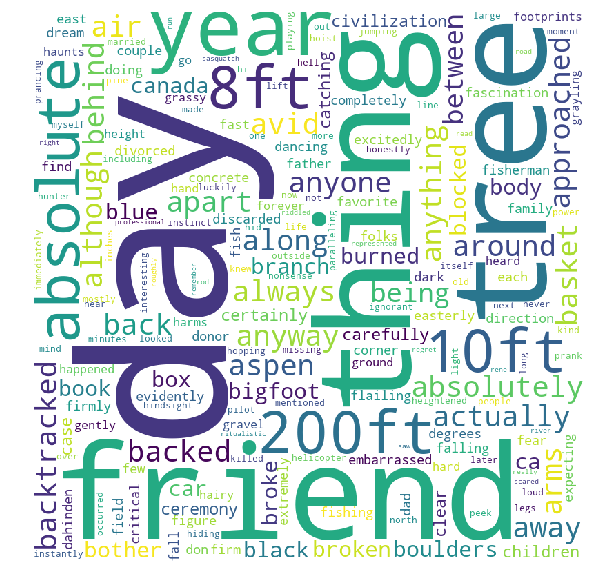

In [341]:

wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = stopwords_, 
                min_font_size = 10).generate(comment_words) 
  
# plot the WordCloud image                        
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.savefig('img/tfidfwordcloud')
  
plt.show() 

In [299]:
yearly_info = data['year'].value_counts()[0:60]

In [303]:
yearly_info = yearly_info.reset_index()

In [308]:
yearly_info = yearly_info.rename(columns={'index': 'year', 'year': 'Squatch_counts'})

In [314]:
convert_dict = {'year': int}

In [315]:
yearly_info = yearly_info.astype(convert_dict)

In [320]:
yearly_info['year'] = yearly_info['year'].sort_values(ascending=True)

In [323]:
yearly_info = yearly_info.sort_values(by=['year'])

In [327]:
yearly_info.head()

,year,Squatch_counts
55,1950,6
59,1955,4
57,1958,6
58,1960,4
54,1961,7


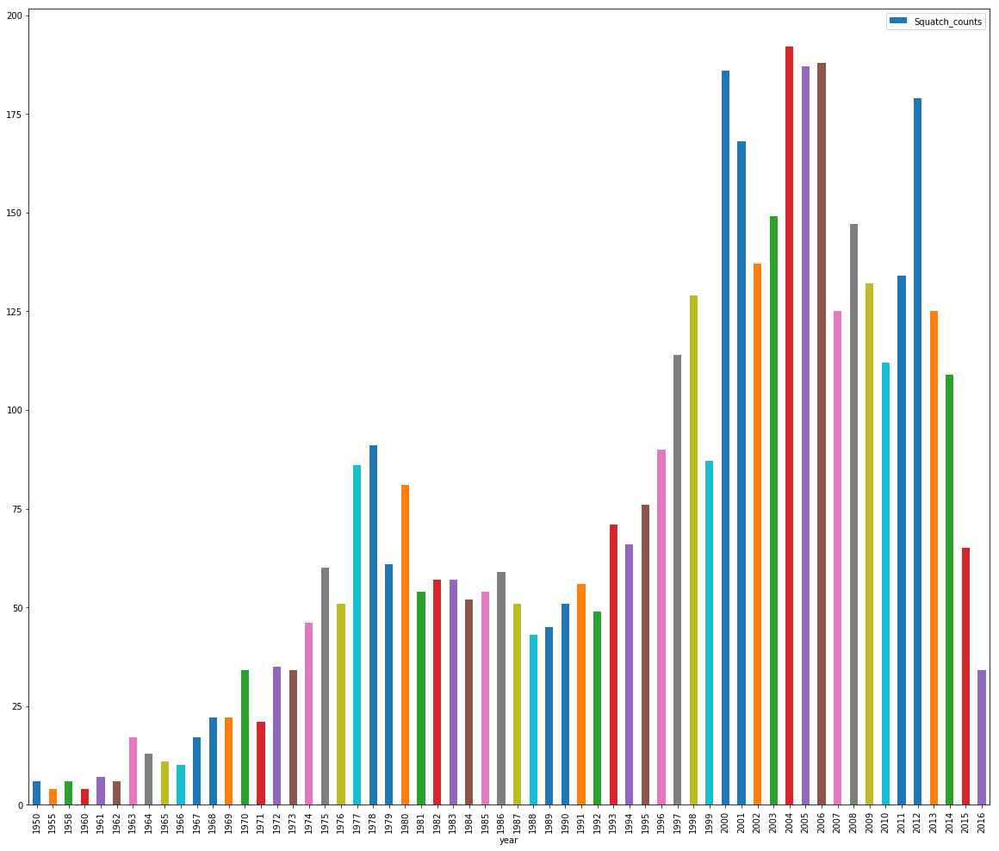

In [339]:
year_fig = yearly_info.plot.bar(x='year', y='Squatch_counts', figsize=(20,17)).get_figure()


In [340]:
year_fig.savefig('img/yearly_bigfoot_coutns.png')

# PCA


In [332]:
from sklearn.decomposition import PCA
from numpy.linalg import eig

In [334]:
pcd = PCA(2)
pcd.fit(document_tfidf_matrix.todense())

PCA(n_components=2)

In [335]:
pcd.components_

array([[-1.74365058e-03, -8.77987858e-03, -1.74365058e-03,
        -1.74365058e-03, -1.74365058e-03, -1.74365058e-03,
        -1.74365058e-03, -1.74365058e-03, -8.77987858e-03,
        -1.74365058e-03, -1.74365058e-03, -1.74365058e-03,
        -8.77987858e-03, -1.74365058e-03, -1.74365058e-03,
        -1.74365058e-03, -1.74365058e-03, -1.74365058e-03,
        -1.74365058e-03, -1.77162935e-02, -4.37063044e-03,
        -1.74365058e-03, -1.74365058e-03, -4.37063044e-03,
        -1.74365058e-03, -1.74365058e-03, -1.74365058e-03,
        -4.37063044e-03, -1.74365058e-03, -4.37063044e-03,
        -8.77987858e-03, -1.74365058e-03, -1.74365058e-03,
        -1.23294715e-03, -1.74365058e-03, -4.37063044e-03,
        -1.74365058e-03, -1.74365058e-03, -1.74365058e-03,
        -8.77987858e-03, -1.74365058e-03, -1.74365058e-03,
        -1.74365058e-03, -1.74365058e-03, -1.74365058e-03,
        -1.74365058e-03, -1.74365058e-03, -1.74365058e-03,
        -1.74365058e-03, -1.74365058e-03, -1.74365058e-0

In [379]:
observed_words_reduced = document_tfidf_matrix @ pcd.components_.T

In [380]:
observed_words_reduced

array([[-1.74365058e-03, -2.86947956e-16],
       [-4.37063044e-03,  1.60892932e-17],
       [-1.74365058e-03, -1.94289029e-16],
       [-4.55077698e-02,  7.55749150e-01],
       [-4.55077698e-02, -1.44333133e-01],
       [-1.74365058e-03, -1.75769670e-16],
       [-1.77162935e-02, -2.44007291e-15],
       [-4.55077698e-02,  7.55749150e-01],
       [-4.37063044e-03, -4.72561897e-16],
       [-4.37063044e-03, -4.03470885e-16],
       [-4.37063044e-03, -3.13259379e-16],
       [-4.37063044e-03, -4.54233360e-16],
       [-4.37063044e-03, -3.38637992e-16],
       [-1.74365058e-03, -2.20076803e-16],
       [-1.77162935e-02, -2.69081881e-15],
       [-1.74365058e-03, -2.11423113e-16],
       [-1.74365058e-03, -2.13830322e-16],
       [-1.74365058e-03, -2.17409697e-16],
       [-4.37063044e-03, -3.24169168e-16],
       [-1.74365058e-03, -2.07868532e-16],
       [-4.37063044e-03, -4.98154993e-16],
       [-8.77987858e-03, -6.79694133e-16],
       [-8.77987858e-03, -9.77376297e-16],
       [-1.

Text(0,0.5,'Second Principal Component')

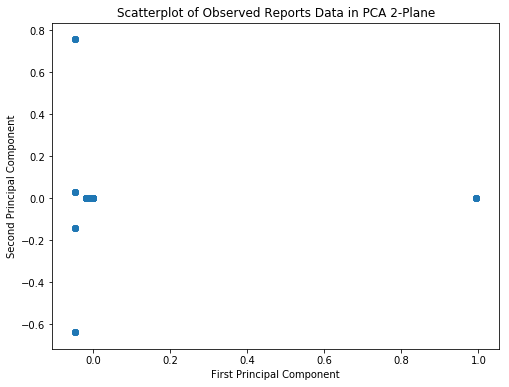

In [384]:
fig, ax = plt.subplots(1, figsize=(8, 6))

ax.scatter(observed_words_reduced[:, 0], observed_words_reduced[:, 1])
ax.set_title("Scatterplot of Observed Reports Data in PCA 2-Plane")
ax.set_xlabel("First Principal Component")
ax.set_ylabel("Second Principal Component")

In [365]:
data1 = pd.read_csv('data/big_foot.csv')

In [372]:
data1.columns

Index(['Unnamed: 0', 'year', 'season', 'month', 'state', 'county',
       'location details', 'nearest town', 'nearest road', 'observed',
       'also noticed', 'other witnesses', 'other stories',
       'time and conditions', 'environment', 'extra', 'date',
       'see photos from silver star mountain', 'country', 'province'],
      dtype='object')

In [374]:
data1 = data1.drop(columns=['Unnamed: 0'])

In [375]:
data1

,year,season,month,state,county,location details,nearest town,nearest road,observed,also noticed,other witnesses,other stories,time and conditions,environment,extra,date,see photos from silver star mountain,country,province
0,2004,Winter,February,Alaska,Anchorage County,Up near powerline clearings east of Potter Mar...,Anchorage / Hillside,No real roads in the area,I and two of my friends were bored one night s...,"Some tracks in the snow, and a clearing in the...",My two friends were snowmachining behind me bu...,I have not heard of any other incidents in Anc...,Middle of the night. The only light was the he...,"In the middle of the woods, in a clearing cove...",Follow-up investigation report by BFRO Investi...,NaN,NaN,NaN,NaN
1,2003,Winter,December,Alaska,Anchorage County,"Few houses on the way, a power relay station. ...",Anchorage,Dowling,"Me and a couple of friends had been bored, whe...","We smelled of colonge and after shave, and one...","4. Me, w-man, warren and sean. We were at my h...",no,"Started at 11, ended at about 3-3 30. Weather ...","A pine forest, with a bog or swamp on the righ...",Follow-up investigation report by BFRO Investi...,Friday night,NaN,NaN,NaN
2,1998,Fall,September,Alaska,Bethel County,"45 miles by air west of Lake Iliamna, Alaska i...",NaN,NaN,My hunting buddy and I were sitting on a ridge...,nothing unusual,Scouting for caribou with high quality binoculars,NaN,NaN,Call Iliamna Air taxi for lat & Long of Long L...,NaN,3,NaN,NaN,NaN
3,2004,Summer,July,Alaska,Bristol Bay County,"Approximately 95 miles east of Egegik, Alaska....",Egegik,NaN,"To whom it may concern, I am a commercial fish...",Just these foot prints and how obvious it was ...,"One other witness, and he was fishing prior to...","I've only heard of one other story, from an ol...","Approximately 12 30 pm, partially coudy/sunny.","Lake front,creek spit, gravel and sand, alder ...",Follow-up investigation report by BFRO Investi...,20,NaN,NaN,NaN
4,2000,Summer,June,Alaska,Cordova-McCarthy County,"On the main trail toward the glacier, before t...","Kennikot, Alaska",not sure,My hiking partner and I arrived late to the Ke...,I did hear what appeared to be grunting in the...,"I was the only witness, there was one other in...",None,About 12 00 Midnight / full moon / clear / dim...,This sighting was located at approximately 1 t...,Follow-up investigation report: Summary of com...,16,NaN,NaN,NaN
5,2009,Summer,July,Alaska,Fairbanks County,The intersection of Auburn and Farmers Loop is...,Fairbanks Alaska,Auburn Dr a mile north of Farmers Loop,"It was the month of July, 2009 in Fairbanks Al...",I saw some people the next day who saw some ki...,No other witnesses,I saw some people the next day who saw some ki...,around 6pmLighting was excellent and weather w...,The forest was made up of mostly birch trees w...,Follow-up investigation report by BFRO Investi...,NaN,NaN,NaN,NaN
6,1998,Spring,May,Alaska,Fairbanks County,Fort Wainwright,NaN,NaN,I personally did not see it but a Noncommissio...,NaN,They had just picked the buddy up from work.,NaN,NaN,"On a road called Trainor Gate road, on the mor...",NaN,22,NaN,NaN,NaN
7,1997,Fall,August,Alaska,Fairbanks County,I would prefer you don't include this in my po...,Fairbanks,Jones Road,This happened in late August of 1997 in a side...,I covered pretty much everything in my narrative.,Just myself.,Most of the native peoples of Alaska seem to h...,"Middle of the night, clear weather, thumbnail ...","Upland Aspen/birch forest, above O'connor Creek.",Follow-up investigation report by BFRO Investi...,"August, 1997",NaN,NaN,NaN
8,Late 1970's,Summer,NaN,Alaska,Fairbanks County,"Black Rapids Glacier, Alaska Richardson Hiway ...",NaN,NaN,I was part of a group of about a dozen Army pe...,NaN,Just sitting around relaxing,I was telling a friend about this and he said ...,NaN,High rugged mountains,NaN,NaN,NaN,NaN,NaN
9,1964,Fall,September,Alaska,Fairbanks County,"This incident occurred back in 1964, and I hav...",NaN,NaN

In [376]:
yearly_info

,year,Squatch_counts
55,1950,6
59,1955,4
57,1958,6
58,1960,4
54,1961,7
56,1962,6
49,1963,17
51,1964,13
52,1965,11
53,1966,10


In [391]:
data1.groupby(['year', 'state']).count()

season  month  county  location details  \
year               state                                                     
'01or '02          West Virginia        1      1       1                 1   
'73-'74?           Oregon               1      1       1                 1   
'92-'93            Tennessee            1      1       1                 0   
'96                California           1      1       1                 1   
04-05              Washington           1      1       1                 0   
04-present         Georgia              1      1       1                 1   
05                 Washington           1      1       1                 1   
07                 New York             1      1       1                 1   
                   Washington           1      1       1                 1   
07-26-08           Arkansas             1      1       1                 1   
08                 Florida              1      1       1                 1   
08-09              Florida              1      1       1                 1   
09-12              Ohio                 1      0       1                 1   
1/5/1998           North Carolina       1      1       1                 1   
1870               California           1      0       1                 0   
1890               Wyoming              1      0       1                 1   
1905               Tennessee            1      0       1                 1   
1910               Michigan             1      0       1                 1   
1920               Arizona              1      0       1                 0   
                   Arkansas             1      0       1                 1   
1921               Pennsylvania         1      1       1                 0   
1925               Louisiana            1      0       1                 0   
1926               Colorado             1      0       1                 1   
1930               Texas                1      0       1                 1   
1930's             New Hampshire        1      0       1                 0   
1932               Missouri             1      0       1                 1   
1937               Indiana              1      1       1                 0   
1938               Texas                1      0       1                 0   
1940               Colorado             1      0       1                 0   
1941               Washington           1      0       1                 1   
...                                   ...    ...     ...               ...   
Maybe 1974         Michigan             1      0       1                 1   
Mid 80's           Pennsylvania         1      1       1                 1   
Mid- to Late-1970s Louisiana            1      0       1                 1   
Ongoing            Georgia              1      1       1                 0   
Sep 2014           Kentucky             1      1       1                 0   
about 1960         West Virginia        1      1       1                 1   
about 1961         Texas                1      0       1                 1   
about 1980         Pennsylvania         1      1       1                 0   
                   Washington           1      1       1                 1   
about 1986         Arizona              1      1       1                 1   
app. 1985          Missouri             1      0       1                 1   
circa 1978         Colorado             1      1       1                 0   
early 2000         Florida              1      0       1                 1   
early 80's         Utah                 1      1       1                 1   
early 90's         Washington           1      1       1                 1   
early90s           Kentucky             1      0       1                 1   
est mid-70         Oregon               1      0       1                 1   
est.1990           West Virginia        1      0       1                 1   
late 60s           Colorado             1      0       1 

In [423]:
state_county = data1.groupby(['state', 'county'])['observed']

In [424]:
countys = data1['county'].value_counts()

In [425]:
countys = countys.reset_index()


In [428]:
countys['County'] = countys['index']

In [431]:
countys = countys.drop(columns=['index'])

In [433]:
countys['count'] = countys['county']

In [435]:
countys = countys.drop(columns=['county'])

In [436]:
countys

,County,count
0,Pierce County,71
1,Snohomish County,50
2,Jefferson County,48
3,Humboldt County,45
4,Washington County,45
5,Lewis County,44
6,Jackson County,41
7,King County,40
8,Skamania County,38
9,Polk County,38


In [442]:
countys_small = countys[:40 :]

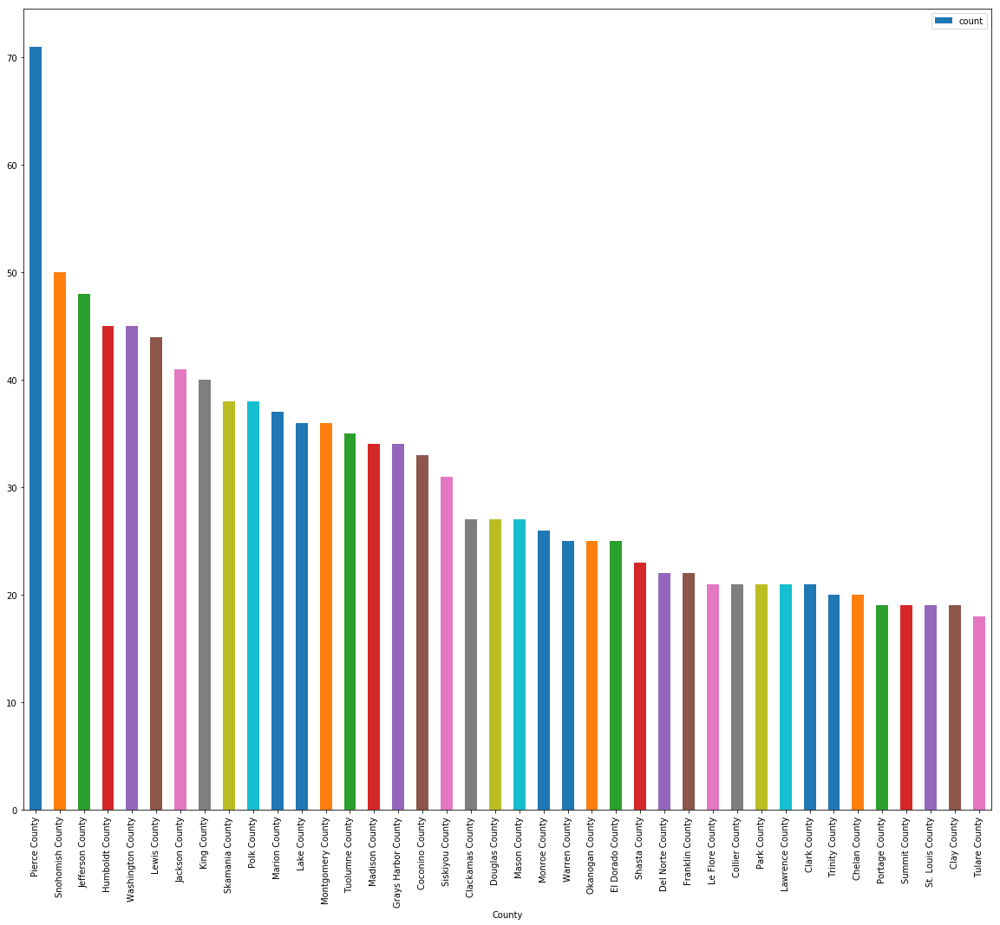

In [444]:
county_fig = countys_small.plot.bar(x='County', y='count', figsize=(20,17)).get_figure()

In [ ]:
county_fig.savefig('img/county_Big')